In this notebook we will use SpatialDE2 to do some spatial analysis: Get spatially variable genes, do spatial clustering, etc.

In [1]:
import os
import sys
import pickle

import numpy as np
import pandas as pd

from scipy.stats import mannwhitneyu, false_discovery_control
from scipy.spatial.distance import pdist, squareform
from scipy.sparse.csgraph import connected_components
from alphashape import alphashape
from descartes.patch import PolygonPatch
import skimage
from shapely.geometry import Point
from shapely.affinity import scale

import matplotlib as mpl
import matplotlib.pyplot as plt

%matplotlib inline

import plotnine
from plotnine import *

import anndata as ad
import scanpy as sc

import sys

sys.path.append("/home/kats/SpatialDE")
import SpatialDE

sys.path.insert(0, "..")
from plot_settings import *

2024-09-23 11:57:07.006999: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudnn.so.8'; dlerror: libcudnn.so.8: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /software/gcc/11.1.0/lib64:/software/gcc/11.1.0/lib:/software/python/3.10.1/lib:/software/python/3.10.1/lib64:/software/r/4.3.1/lib64/R/lib
2024-09-23 11:57:07.007020: W tensorflow/core/common_runtime/gpu/gpu_device.cc:1850] Cannot dlopen some GPU libraries. Please make sure the missing libraries mentioned above are installed properly if you would like to use GPU. Follow the guide at https://www.tensorflow.org/install/gpu for how to download and setup the required libraries for your platform.
Skipping registering GPU devices...


We read in the AnnData files created in the first notebook.

In [2]:
adatas = {}
for f in os.scandir("adatas/"):
    adatas[os.path.splitext(f.name)[0]] = ad.read_h5ad(f.path)

We use SpatialDE2 to test for spatially variable genes, i.e. genes that have structured spatial variability as opposed to random noise.

In [4]:
vargenes = {}
for sample, adata in adatas.items():
    vargenes[sample], _ = SpatialDE.test(adata, layer="counts", omnibus=True)

2022-09-29 09:23:50.782599: I tensorflow/compiler/xla/service/service.cc:170] XLA service 0x1f1322a0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2022-09-29 09:23:50.782627: I tensorflow/compiler/xla/service/service.cc:178]   StreamExecutor device (0): NVIDIA TITAN RTX, Compute Capability 7.5
2022-09-29 09:23:53.011371: I tensorflow/compiler/jit/xla_compilation_cache.cc:478] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


  0%|          | 0/10326 [00:00<?, ?it/s]

2022-09-29 09:23:54.401716: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:263] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2022-09-29 09:23:55.921592: I tensorflow/stream_executor/gpu/asm_compiler.cc:323] ptxas warning : Registers are spilled to local memory in function 'input_fusion_reduce'
ptxas warning : Registers are spilled to local memory in function '__cuda_sm20_div_f64_slowpath_v2'
ptxas warning : Registers are spilled to local memory in function '__internal_trig_reduction_slowpathd'

2022-09-29 09:23:57.123305: I tensorflow/stream_executor/gpu/asm_compiler.cc:323] ptxas warning : Registers are spilled to local memory in function 'input_fusion_reduce'
ptxas warning : Registers are spilled to local memory in function '__cuda_sm20_div_f64_slowpath_v2'
ptxas warning : Registers are spilled to local memory in function '__internal_trig_reduction_slowpathd'



  0%|          | 0/12165 [00:00<?, ?it/s]

2022-09-29 09:30:03.289149: I tensorflow/stream_executor/gpu/asm_compiler.cc:323] ptxas warning : Registers are spilled to local memory in function 'input_fusion_reduce'
ptxas warning : Registers are spilled to local memory in function '__cuda_sm20_div_f64_slowpath_v2'
ptxas warning : Registers are spilled to local memory in function '__internal_trig_reduction_slowpathd'

2022-09-29 09:30:04.584678: I tensorflow/stream_executor/gpu/asm_compiler.cc:323] ptxas warning : Registers are spilled to local memory in function 'input_fusion_reduce'
ptxas warning : Registers are spilled to local memory in function '__cuda_sm20_div_f64_slowpath_v2'
ptxas warning : Registers are spilled to local memory in function '__internal_trig_reduction_slowpathd'



  0%|          | 0/10278 [00:00<?, ?it/s]

2022-09-29 09:34:45.145689: I tensorflow/stream_executor/gpu/asm_compiler.cc:323] ptxas warning : Registers are spilled to local memory in function 'input_fusion_reduce'

2022-09-29 09:34:46.230822: I tensorflow/stream_executor/gpu/asm_compiler.cc:323] ptxas warning : Registers are spilled to local memory in function 'input_fusion_reduce'
ptxas warning : Registers are spilled to local memory in function '__cuda_sm20_div_f64_slowpath_v2'
ptxas warning : Registers are spilled to local memory in function '__internal_trig_reduction_slowpathd'



  0%|          | 0/10774 [00:00<?, ?it/s]

2022-09-29 09:42:22.649202: I tensorflow/stream_executor/gpu/asm_compiler.cc:323] ptxas warning : Registers are spilled to local memory in function 'input_fusion_reduce'
ptxas warning : Registers are spilled to local memory in function '__cuda_sm20_div_f64_slowpath_v2'
ptxas warning : Registers are spilled to local memory in function '__internal_trig_reduction_slowpathd'

2022-09-29 09:42:23.955686: I tensorflow/stream_executor/gpu/asm_compiler.cc:323] ptxas warning : Registers are spilled to local memory in function 'input_fusion_reduce'
ptxas warning : Registers are spilled to local memory in function '__cuda_sm20_div_f64_slowpath_v2'
ptxas warning : Registers are spilled to local memory in function '__internal_trig_reduction_slowpathd'



  0%|          | 0/10859 [00:00<?, ?it/s]

2022-09-29 09:49:25.733907: I tensorflow/stream_executor/gpu/asm_compiler.cc:323] ptxas warning : Registers are spilled to local memory in function 'input_fusion_reduce'
ptxas warning : Registers are spilled to local memory in function '__cuda_sm20_div_f64_slowpath_v2'
ptxas warning : Registers are spilled to local memory in function '__internal_trig_reduction_slowpathd'

2022-09-29 09:49:26.888749: I tensorflow/stream_executor/gpu/asm_compiler.cc:323] ptxas warning : Registers are spilled to local memory in function 'input_fusion_reduce'
ptxas warning : Registers are spilled to local memory in function '__cuda_sm20_div_f64_slowpath_v2'
ptxas warning : Registers are spilled to local memory in function '__internal_trig_reduction_slowpathd'



  0%|          | 0/12322 [00:00<?, ?it/s]

2022-09-29 09:53:40.080996: I tensorflow/stream_executor/gpu/asm_compiler.cc:323] ptxas warning : Registers are spilled to local memory in function 'input_fusion_reduce'
ptxas warning : Registers are spilled to local memory in function '__cuda_sm20_div_f64_slowpath_v2'
ptxas warning : Registers are spilled to local memory in function '__internal_trig_reduction_slowpathd'

2022-09-29 09:53:41.521146: I tensorflow/stream_executor/gpu/asm_compiler.cc:323] ptxas warning : Registers are spilled to local memory in function 'input_fusion_reduce'
ptxas warning : Registers are spilled to local memory in function '__cuda_sm20_div_f64_slowpath_v2'
ptxas warning : Registers are spilled to local memory in function '__internal_trig_reduction_slowpathd'



  0%|          | 0/11539 [00:00<?, ?it/s]

2022-09-29 09:59:32.855982: I tensorflow/stream_executor/gpu/asm_compiler.cc:323] ptxas warning : Registers are spilled to local memory in function 'input_fusion_reduce'
ptxas warning : Registers are spilled to local memory in function '__cuda_sm20_div_f64_slowpath_v2'
ptxas warning : Registers are spilled to local memory in function '__internal_trig_reduction_slowpathd'

2022-09-29 09:59:34.062541: I tensorflow/stream_executor/gpu/asm_compiler.cc:323] ptxas warning : Registers are spilled to local memory in function 'input_fusion_reduce'
ptxas warning : Registers are spilled to local memory in function '__cuda_sm20_div_f64_slowpath_v2'
ptxas warning : Registers are spilled to local memory in function '__internal_trig_reduction_slowpathd'



  0%|          | 0/11182 [00:00<?, ?it/s]

2022-09-29 10:04:57.325271: I tensorflow/stream_executor/gpu/asm_compiler.cc:323] ptxas warning : Registers are spilled to local memory in function 'input_fusion_reduce'
ptxas warning : Registers are spilled to local memory in function '__cuda_sm20_div_f64_slowpath_v2'
ptxas warning : Registers are spilled to local memory in function '__internal_trig_reduction_slowpathd'

2022-09-29 10:04:58.618631: I tensorflow/stream_executor/gpu/asm_compiler.cc:323] ptxas warning : Registers are spilled to local memory in function 'input_fusion_reduce'
ptxas warning : Registers are spilled to local memory in function '__cuda_sm20_div_f64_slowpath_v2'
ptxas warning : Registers are spilled to local memory in function '__internal_trig_reduction_slowpathd'



  0%|          | 0/11350 [00:00<?, ?it/s]

2022-09-29 10:11:38.424336: I tensorflow/stream_executor/gpu/asm_compiler.cc:323] ptxas warning : Registers are spilled to local memory in function 'input_fusion_reduce'
ptxas warning : Registers are spilled to local memory in function '__cuda_sm20_div_f64_slowpath_v2'



  0%|          | 0/11495 [00:00<?, ?it/s]

2022-09-29 10:16:13.253789: I tensorflow/stream_executor/gpu/asm_compiler.cc:323] ptxas warning : Registers are spilled to local memory in function 'input_fusion_reduce'
ptxas warning : Registers are spilled to local memory in function '__cuda_sm20_div_f64_slowpath_v2'
ptxas warning : Registers are spilled to local memory in function '__internal_trig_reduction_slowpathd'

2022-09-29 10:16:14.565544: I tensorflow/stream_executor/gpu/asm_compiler.cc:323] ptxas warning : Registers are spilled to local memory in function 'input_fusion_reduce'
ptxas warning : Registers are spilled to local memory in function '__cuda_sm20_div_f64_slowpath_v2'
ptxas warning : Registers are spilled to local memory in function '__internal_trig_reduction_slowpathd'



  0%|          | 0/11739 [00:00<?, ?it/s]

2022-09-29 10:21:13.542318: I tensorflow/stream_executor/gpu/asm_compiler.cc:323] ptxas warning : Registers are spilled to local memory in function 'input_fusion_reduce'
ptxas warning : Registers are spilled to local memory in function '__cuda_sm20_div_f64_slowpath_v2'
ptxas warning : Registers are spilled to local memory in function '__internal_trig_reduction_slowpathd'

2022-09-29 10:21:14.692925: I tensorflow/stream_executor/gpu/asm_compiler.cc:323] ptxas warning : Registers are spilled to local memory in function 'input_fusion_reduce'
ptxas warning : Registers are spilled to local memory in function '__cuda_sm20_div_f64_slowpath_v2'
ptxas warning : Registers are spilled to local memory in function '__internal_trig_reduction_slowpathd'



  0%|          | 0/12107 [00:00<?, ?it/s]

2022-09-29 10:27:42.646959: I tensorflow/stream_executor/gpu/asm_compiler.cc:323] ptxas warning : Registers are spilled to local memory in function 'input_fusion_reduce'
ptxas warning : Registers are spilled to local memory in function '__internal_trig_reduction_slowpathd'



  0%|          | 0/10279 [00:00<?, ?it/s]

2022-09-29 10:31:37.277792: I tensorflow/stream_executor/gpu/asm_compiler.cc:323] ptxas warning : Registers are spilled to local memory in function 'input_fusion_reduce'
ptxas warning : Registers are spilled to local memory in function '__cuda_sm20_div_f64_slowpath_v2'
ptxas warning : Registers are spilled to local memory in function '__internal_trig_reduction_slowpathd'

2022-09-29 10:31:38.432928: I tensorflow/stream_executor/gpu/asm_compiler.cc:323] ptxas warning : Registers are spilled to local memory in function 'input_fusion_reduce'
ptxas warning : Registers are spilled to local memory in function '__cuda_sm20_div_f64_slowpath_v2'
ptxas warning : Registers are spilled to local memory in function '__internal_trig_reduction_slowpathd'



In [5]:
pickle.dump(vargenes, open("vargenes.pkl", "wb"))

In [3]:
vargenes = pickle.load(open("vargenes.pkl", "rb"))

We now use the 2000 most highly expressed variable genes to define transcriptionally similar regions in space. We use SpatialDE2's spatial clustering algorithm that incorporates a spatial smoothness assumption: neighboring spots are more likely to belong to the same region.

In [4]:
segmentations = {}
for sample, adata in adatas.items():
    genes = (
        vargenes[sample]
        .query("padj < 0.001 and not gene.str.startswith('MT-').values")
        .set_index("gene")
        .assign(totalcounts=adata.var.total_counts)
        .sort_values("totalcounts", ascending=False)
        .iloc[
            :2000,
        ]
        .index.values
    )
    segmentations[sample] = SpatialDE.tissue_segmentation(
        adata, layer="counts", genes=genes, rng=np.random.default_rng(42)
    )

We write the AnnData objects with the clustering results to disk.

In [ ]:
for sample, adata in adatas.items():
    adata.write_h5ad(f"adatas/{sample}.h5ad", compression="gzip", compression_opts=9)

The spatial clustering results are plotted.

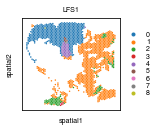

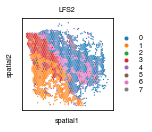

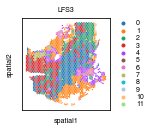

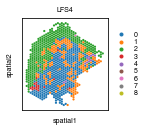

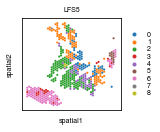

...

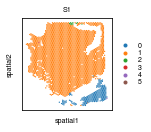

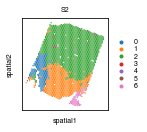

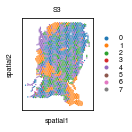

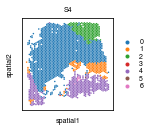

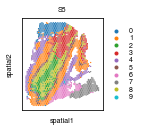

In [5]:
with mpl.rc_context({"figure.figsize": (2, 1.7), "legend.labelspacing": 0.05, "legend.markerscale": 0.5}):
    for sample in sorted(adatas.keys()):
        sc.pl.spatial(adatas[sample], color="segmentation_labels", title=human_sample_map[sample], img_key=None, size=1.5, show=False)
        plt.savefig(f"figures/S2_{sample}.svgz")
        plt.show()

We now use the spatial clustering results to investigate transcriptional heterogeneity in LSF vs. sporadic medulloblastoma. To that end we look at the number of detected regions, normalized by the number of spots. Since the same settings were used for all samples, this should be somewhat reliable.

In [6]:
df = []
for sample, adata in adatas.items():
    regions, counts = np.unique(adata.obs.segmentation_labels, return_counts=True)
    df.append(
        pd.DataFrame(
            {
                "sample": [human_sample_map[sample]],
                "nregions": (counts > 4).sum(),
                "nspots": adata.n_obs,
                "type": "LFS" if int(sample[0]) <= 3 else "sporadic"
            }
        )
    )
df = pd.concat(df).sort_values("sample").reset_index(drop=True)

In [7]:
df

,sample,nregions,nspots,type
0,LFS1,6,1590,LFS
1,LFS2,6,2642,LFS
2,LFS3,8,2469,LFS
3,LFS4,5,881,LFS
4,LFS5,7,500,LFS
5,LFS6,7,631,LFS
6,LFS7,5,537,LFS
7,LFS8,9,3983,LFS
8,S1,3,2966,sporadic
9,S2,5,2621,sporadic


/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 0.9 x 1.95 in image.
/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/1A_heterogeneity.svgz


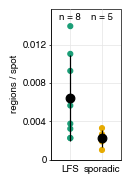

In [8]:
p = (
    ggplot(df, aes("type", "nregions/nspots", color="type"))
    + geom_point()
    + stat_summary(geom="pointrange", fun_data="mean_sdl", fun_args={"mult": 1}, color="black", fatten=6)
    + scale_y_continuous(limits=(0, None), expand=(0, 0, 0.05, 0))
    + labs(x=None, y="regions / spot")
    + guides(color=None)
    + lfs_sporadic_color_scale
    + theme(aspect_ratio="auto", axis_ticks_major_x=element_blank(), figure_size=(0.9, 1.95))
    + annotate("text", x=1, y=0.015, label="n = 8", size=7)
    + annotate("text", x=2, y=0.015, label="n = 5", size=7)
)
p.save("figures/1A_heterogeneity.svgz")
print(p)

In [9]:
mannwhitneyu(
    (df.nregions / df.nspots)[df.type == "LFS"],
    (df.nregions / df.nspots)[df.type != "LFS"],
    alternative="greater",
)

MannwhitneyuResult(statistic=33.0, pvalue=0.03263403263403264)

We now create some plots for the paper figures. The region annotations were determined manually based on genes that were differentially expressed in a region compared to other regions (see below).

In [10]:
adatas["1.3"].obs["segmentation_labels_names"] = adatas[
    "1.3"
].obs.segmentation_labels.cat.rename_categories(
    {
        0: "0: Proliferation",
        1: "1: Malignant cells, cycling, SHH 1",
        2: "2: Malignant cells, cycling, SHH 2",
        3: "3: Neuronal development 1",
        4: "4: Vasculature, inflammation",
        6: "6: Cellular stress response",
        7: "7: Neuronal development 2",
        8: "8: Biosynthesis, metabolism",
        9: "9: Mitotic progression, DNA repair",
        10: "10: Fibrosis, vasculature",
    }
)
adatas["3.4"].obs["segmentation_labels_names"] = adatas[
    "3.4"
].obs.segmentation_labels.cat.rename_categories(
    {
        0: "0: Inflammation",
        1: "1: Proliferation",
        2: "2: Neuronal differentiation 1",
        3: "3: Proliferation and migration",
        4: "4: Malignant (resistant)",
        5: "5: Neuronal differentiation 2",
        6: "6: Immune infiltration",
        7: "7: Vasculature, extracellular matrix",
        9: "9: Oxidative stress response, metabolism",
    }
)
adatas["4.3"].obs["segmentation_labels_names"] = adatas[
    "4.3"
].obs.segmentation_labels.cat.rename_categories(
    {
        0: "0: SHH signaling, Malignant",
        1: "1: Immune infiltration",
        2: "2: Neurogenesis and neuronal differentiation",
        6: "3: Connective tissue, collagen"
    }
)

/home/kats/.local/lib/python3.10/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.


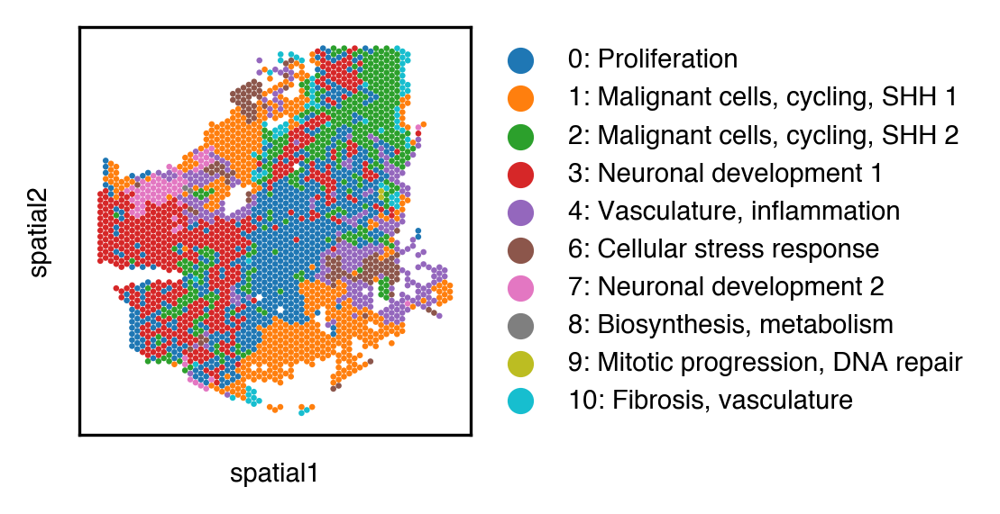

/home/kats/.local/lib/python3.10/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.


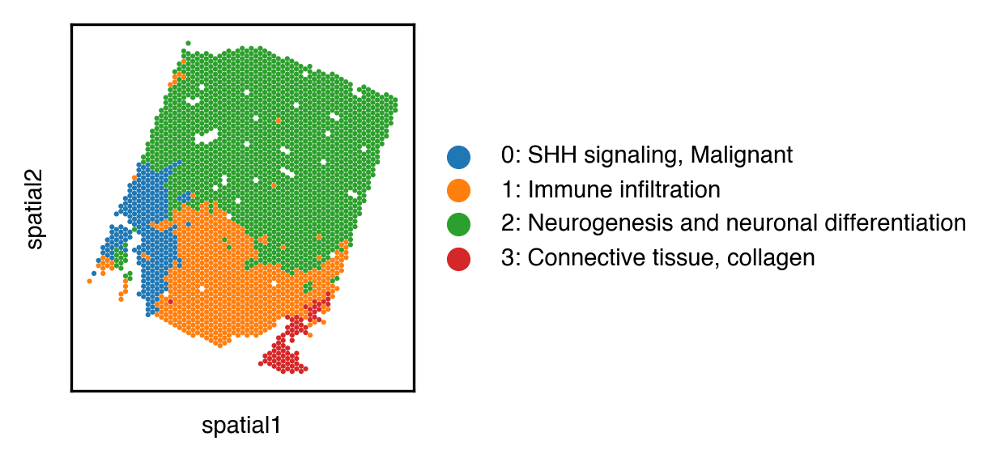

In [11]:
with mpl.rc_context({"figure.figsize": (6, 2), "figure.dpi": 300}):
    for sample in ("1.3", "4.3"):
        adata = adatas[sample]
        clabels = (
            adata.obs.segmentation_labels[
                adata.obs.segmentation_labels.astype(str) != adata.obs.segmentation_labels_names.astype(str)
            ]
            .value_counts()
            .loc[lambda x: x > 1]
            .index
        )
        adata = adata[adata.obs.segmentation_labels.isin(clabels), :]
        sc.pl.spatial(
            adata,
            color="segmentation_labels_names",
            title="",
            img_key=None,
            size=1.5,
            show=False,
        )
        plt.savefig(f"figures/1A_{sample}.svgz")
        plt.show()

/home/kats/.local/lib/python3.10/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.


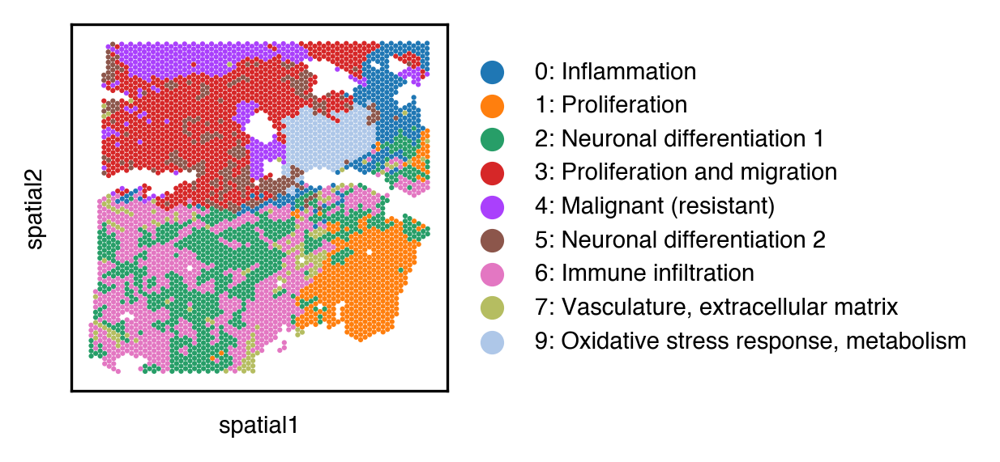

In [12]:
with mpl.rc_context({"figure.figsize": (6, 2), "figure.dpi": 300}):
    adata = adatas["3.4"]
    clabels = adata.obs.segmentation_labels.value_counts().loc[lambda x: x > 1].index
    adata = adata[adata.obs.segmentation_labels.isin(clabels), :]
    sc.pl.spatial(
        adata,
        color="segmentation_labels_names",
        title="",
        img_key=None,
        size=1.5,
        show=False,
        palette={i: c for i, c in zip(adatas["3.4"].obs.segmentation_labels_names.cat.categories, adatas["3.4"].uns["segmentation_labels_colors"])},
    )
    plt.savefig(f"figures/7.svgz")

In [13]:
tmp = {}
for sname in ("1.3", "4.3"): 
    adata = adatas[sname]
    clabels = (
            adata.obs.segmentation_labels[
                adata.obs.segmentation_labels.astype(str) != adata.obs.segmentation_labels_names.astype(str)
            ]
            .value_counts()
            .loc[lambda x: x > 1]
            .index
        )
    adata = adata[adata.obs.segmentation_labels.isin(clabels), :]
    adata.uns["log1p"]["base"] = None
    sc.tl.rank_genes_groups(adata, "segmentation_labels_names", method="wilcoxon")
    tmp[sname] = adata

/home/kats/.local/lib/python3.10/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
/home/kats/.local/lib/python3.10/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.


/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


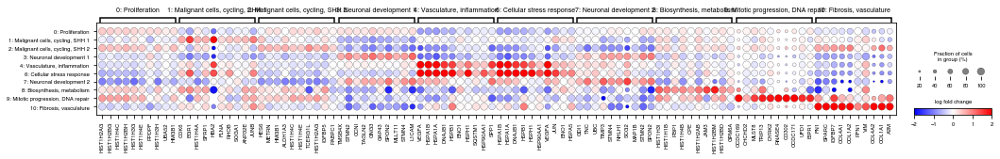

In [14]:
dplt = sc.pl.rank_genes_groups_dotplot(
    tmp["1.3"],
    dendrogram=False,
    var_group_rotation=0,
    values_to_plot="logfoldchanges",
    cmap="bwr",
    vmin=-2,
    vmax=2,
    figsize=(17,1.8),
    return_fig=True
)
dplt.largest_dot=60
dplt.savefig("figures/S3_1.3_dotplot.svgz")

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


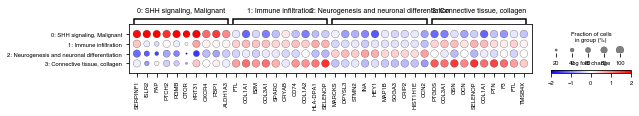

In [15]:
dplt = sc.pl.rank_genes_groups_dotplot(
    tmp["4.3"],
    dendrogram=False,
    var_group_rotation=0,
    values_to_plot="logfoldchanges",
    cmap="bwr",
    vmin=-2,
    vmax=2,
    figsize=(9,0.9),
    return_fig=True
)
dplt.largest_dot=60
dplt.savefig("figures/S3_4.3_dotplot.svgz")

The plots below are not part of the paper, but were used to annotate the regions. We used Scanpy to find genes for each region that were differentially expressed in that region compared to other regions.

/home/kats/.local/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.


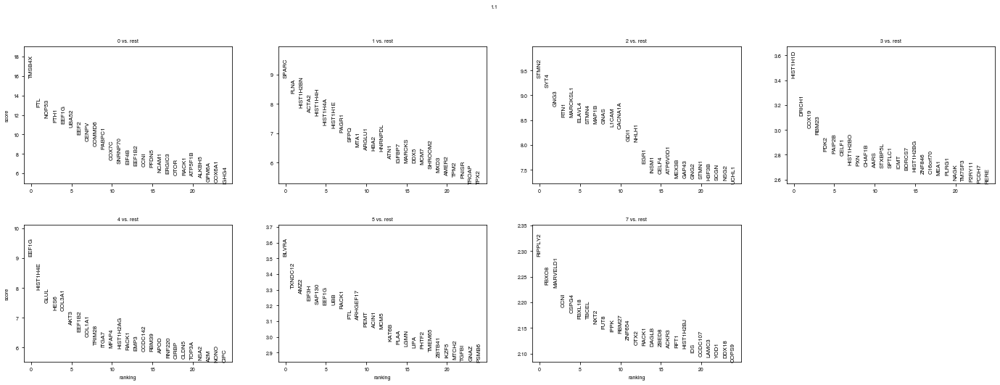

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


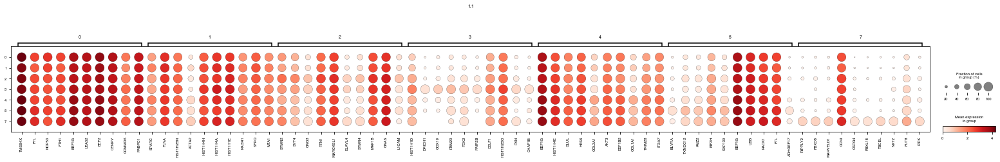

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


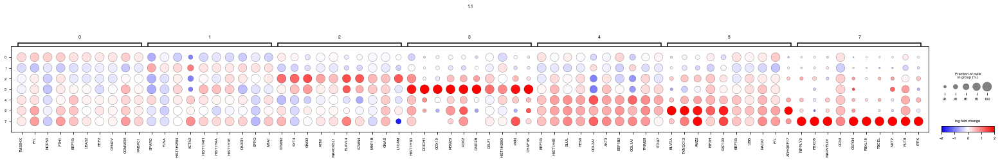

/home/kats/.local/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.


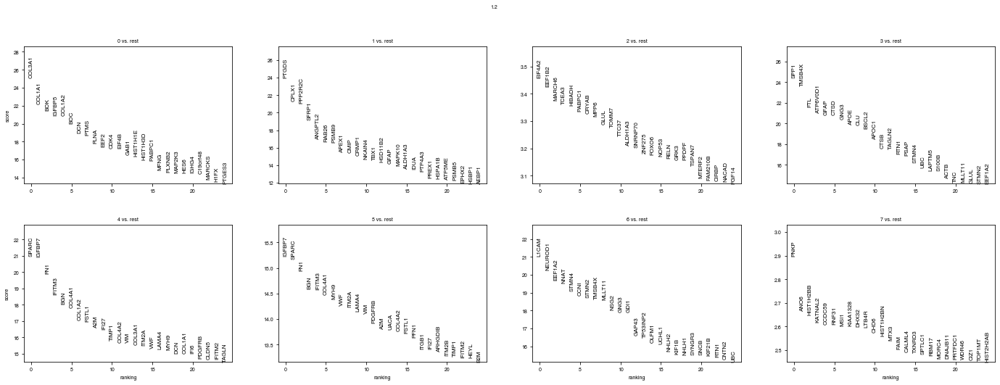

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


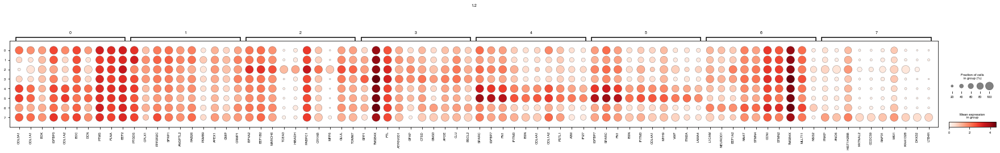

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


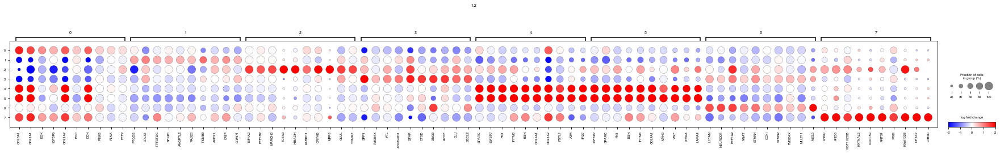

/home/kats/.local/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.


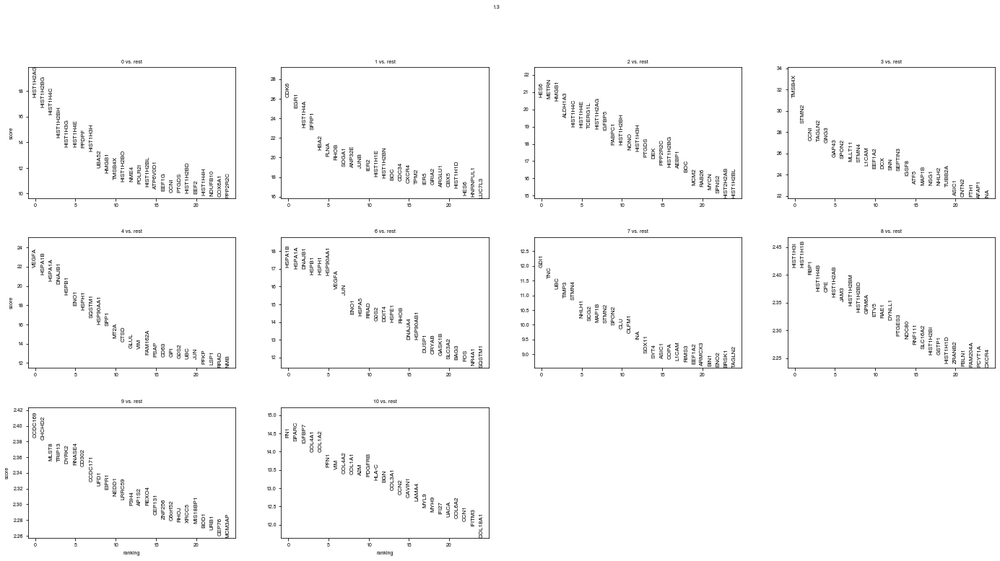

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


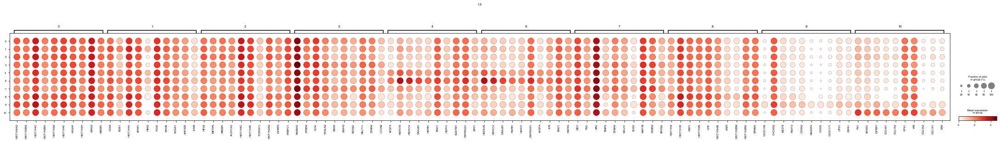

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


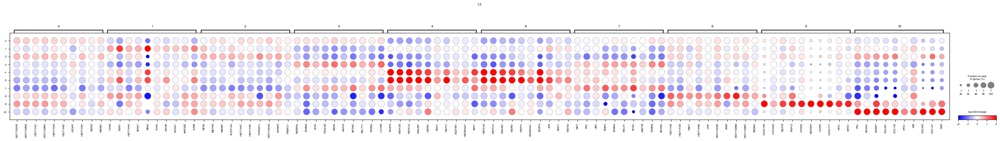

/home/kats/.local/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.


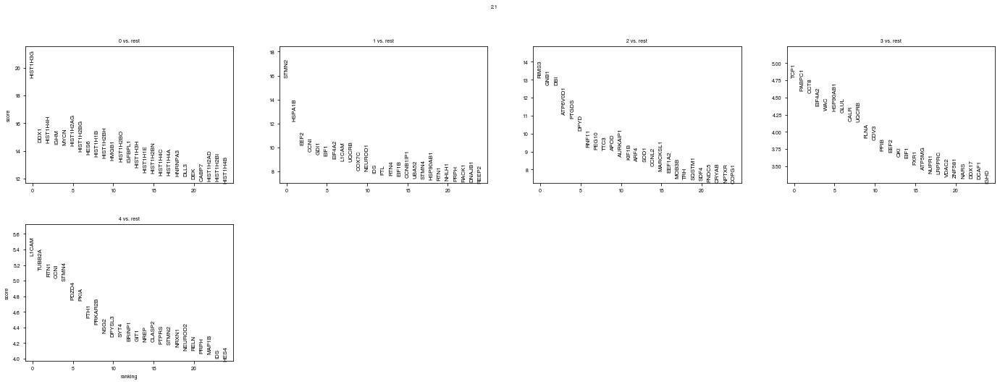

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


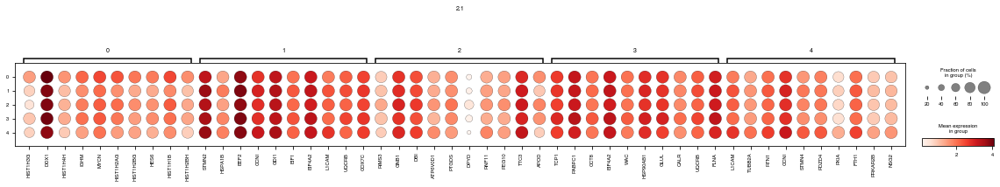

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


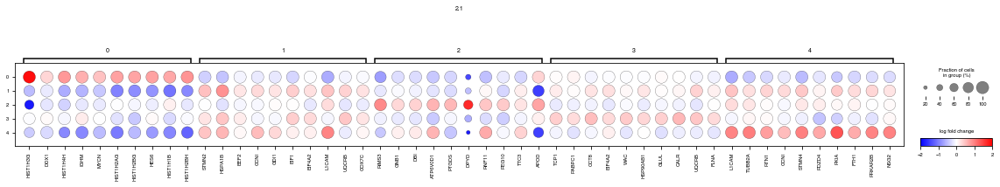

/home/kats/.local/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.


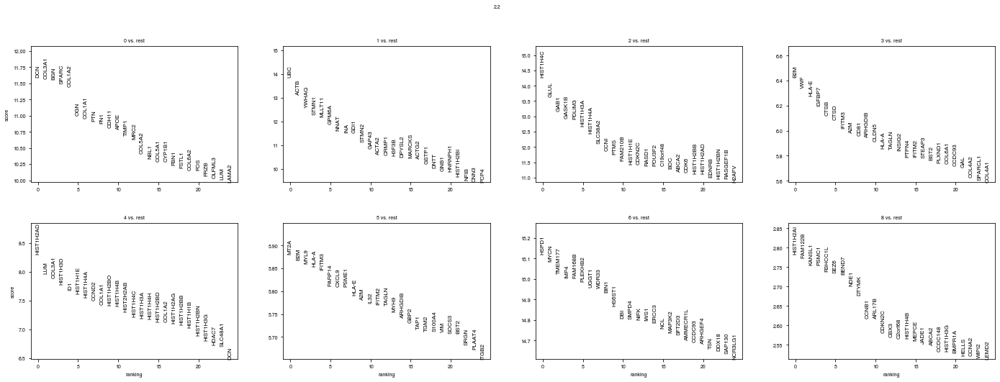

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


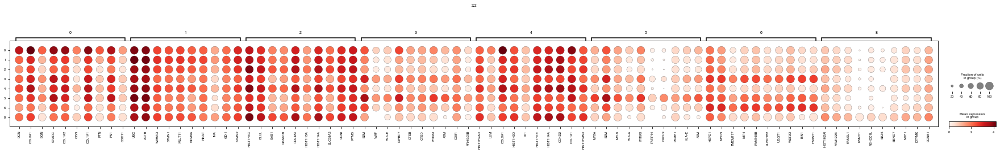

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


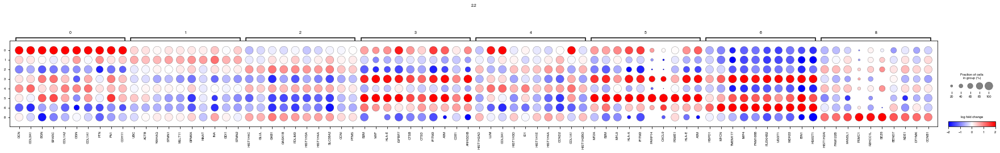

/home/kats/.local/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.


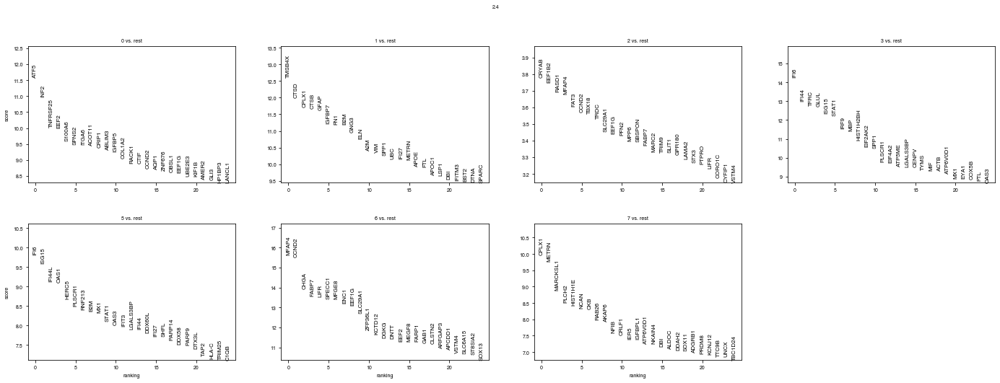

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


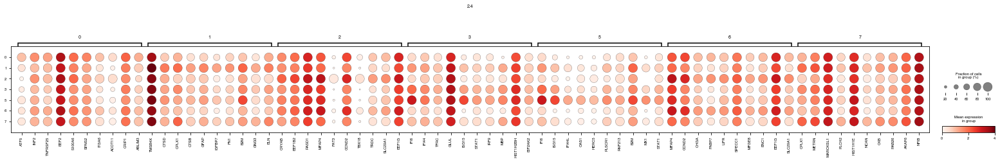

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


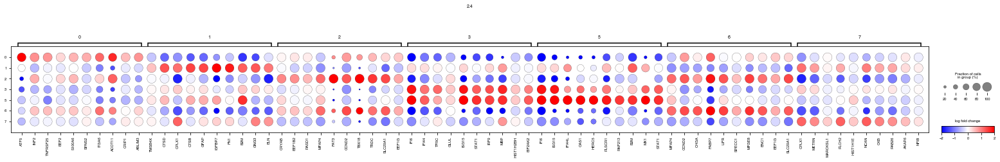

/home/kats/.local/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.


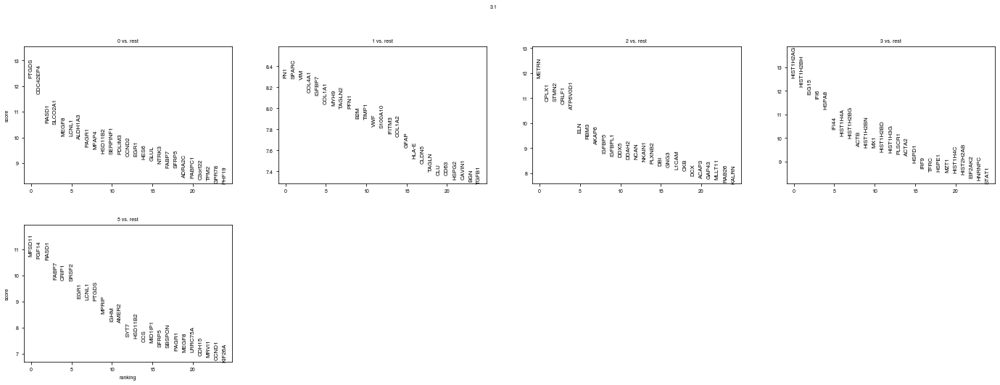

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


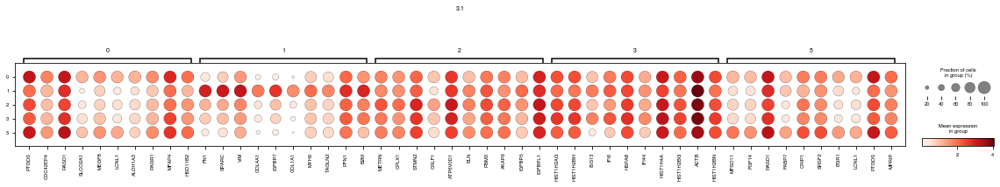

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


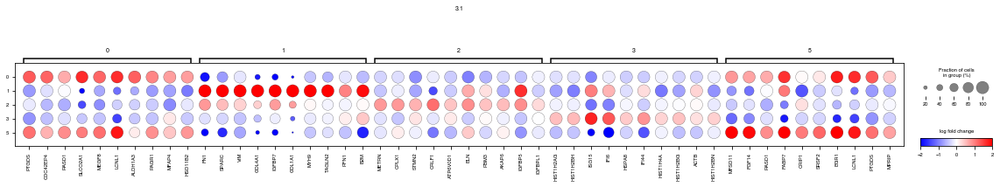

/home/kats/.local/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.


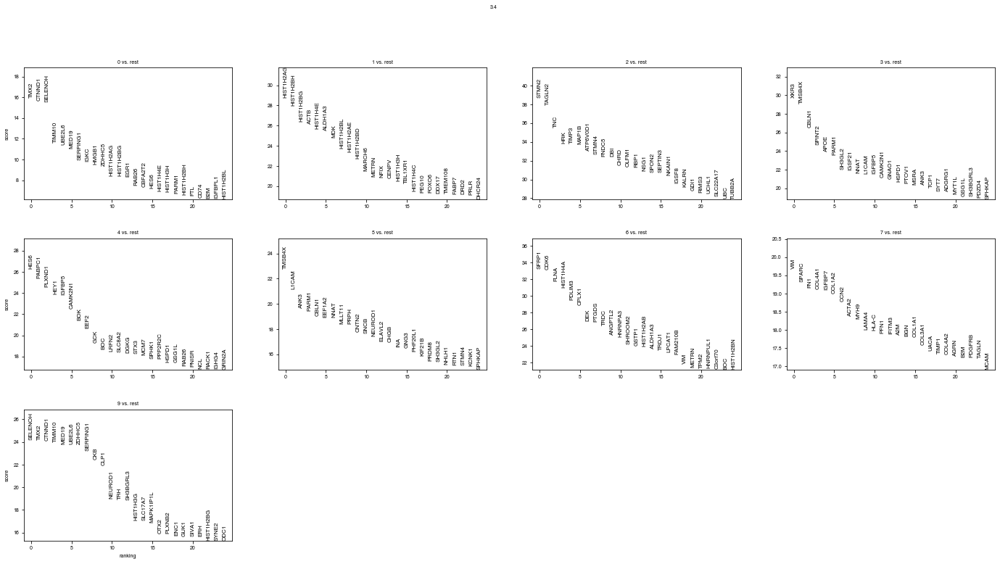

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


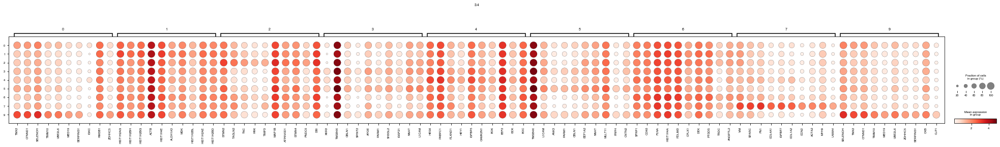

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


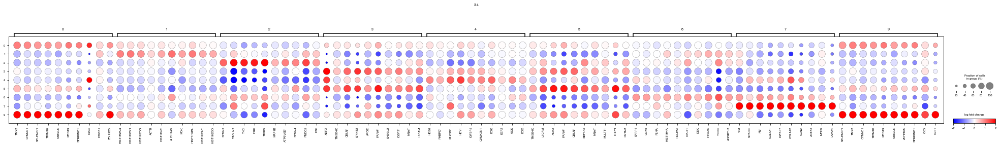

/home/kats/.local/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.


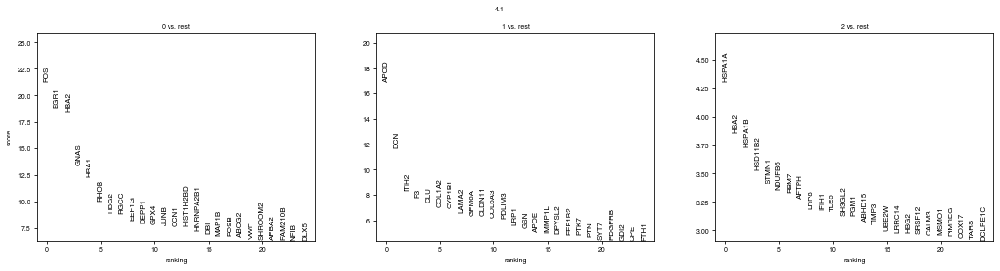

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


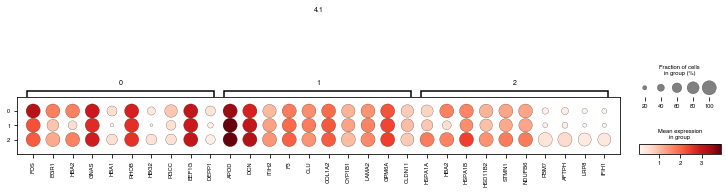

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


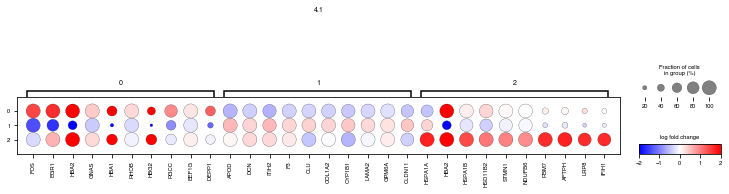

/home/kats/.local/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.


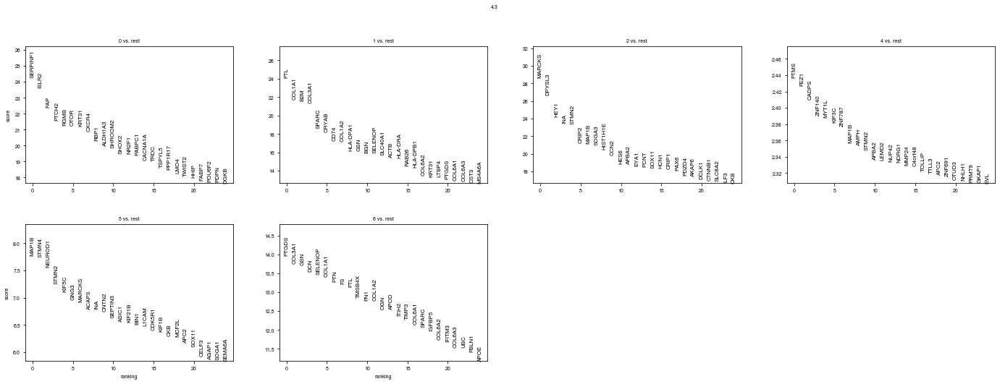

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


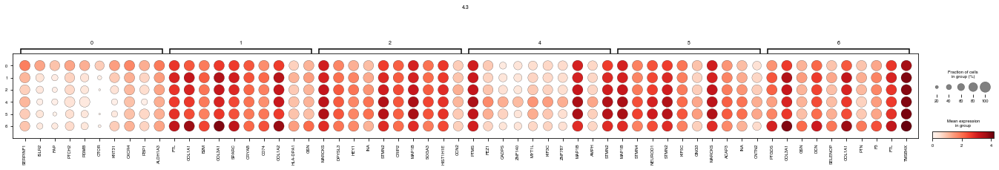

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


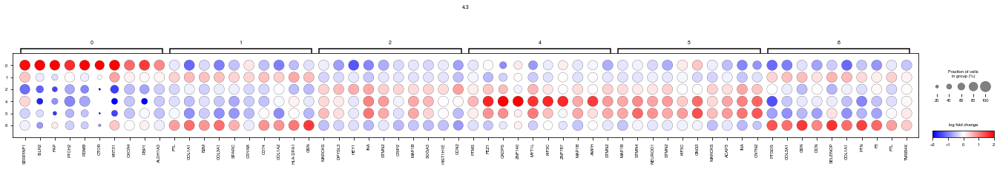

/home/kats/.local/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.


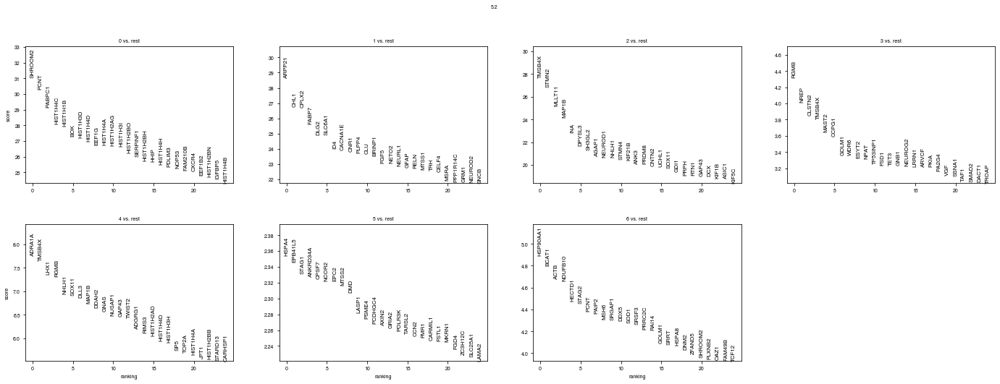

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


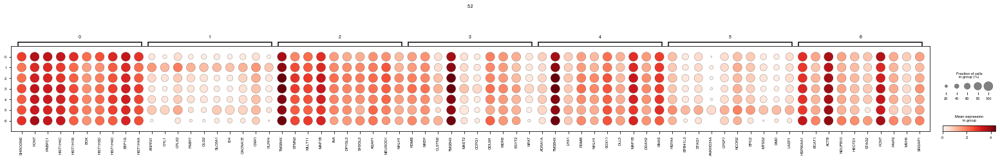

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


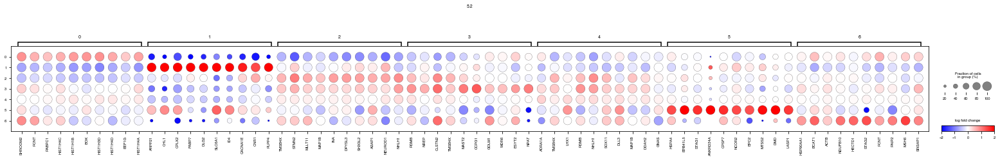

/home/kats/.local/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.


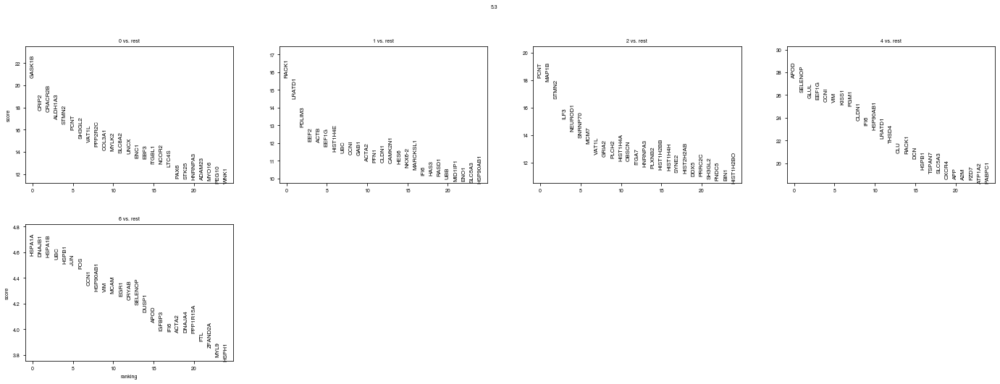

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


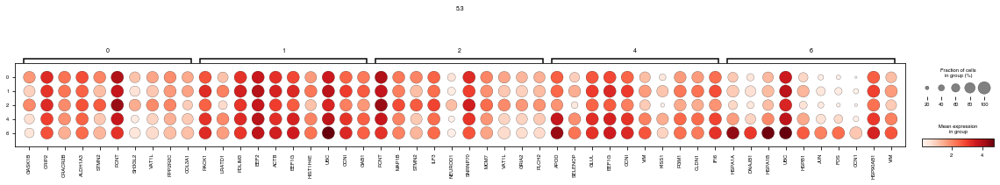

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


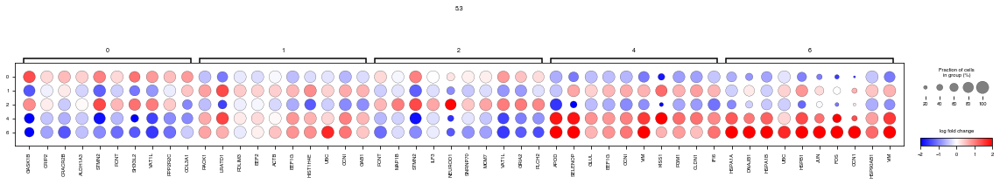

/home/kats/.local/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.


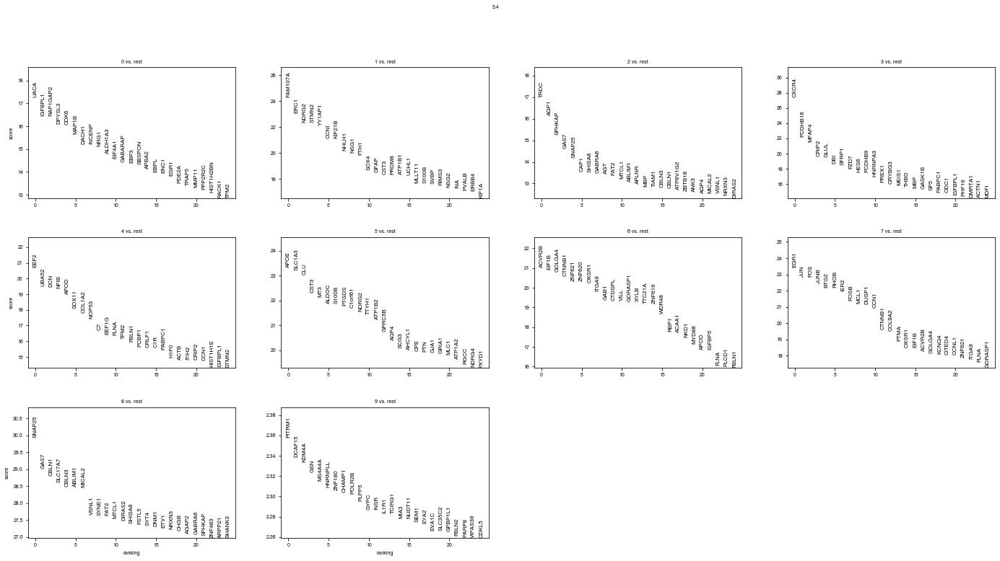

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


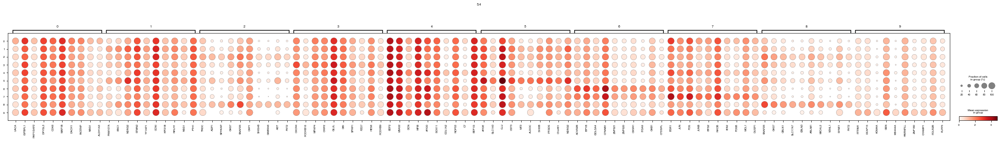

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


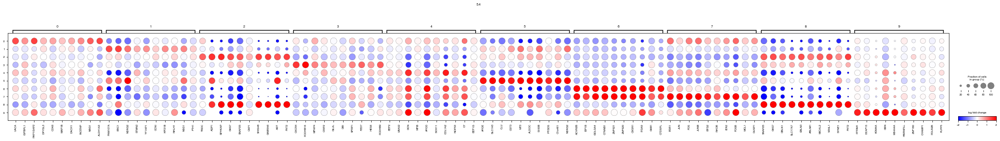

In [16]:
with pd.ExcelWriter("spatialde_regions_rank_genes_groups.xlsx") as writer:
    for sname in sorted(adatas.keys()):
        adata = adatas[sname]
        adata.obs.segmentation_labels = adata.obs.segmentation_labels.astype(str)
        clabels = (
            adata.obs.segmentation_labels.value_counts().loc[lambda x: x > 1].index
        )
        adata = adata[adata.obs.segmentation_labels.isin(clabels), :]
        adata.uns["log1p"]["base"] = None
        sc.tl.rank_genes_groups(adata, "segmentation_labels", method="wilcoxon")
        sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False, show=False)
        plt.gcf().suptitle(sname)
        plt.show()

        sc.pl.rank_genes_groups_dotplot(adata, dendrogram=False, title=sname)
        sc.pl.rank_genes_groups_dotplot(
            adata,
            dendrogram=False,
            values_to_plot="logfoldchanges",
            cmap="bwr",
            vmin=-2,
            vmax=2,
            title=sname,
        )

        df = pd.concat(
            (
                pd.DataFrame(adata.uns["rank_genes_groups"]["scores"])
                .iloc[:25, :]
                .melt(var_name="region", value_name="score"),
                pd.DataFrame(adata.uns["rank_genes_groups"]["names"])
                .iloc[:25, :]
                .melt(var_name="region", value_name="gene")
                .drop(columns="region"),
            ),
            axis=1,
        )
        df.to_excel(writer, sheet_name=sname, index=False)

To further investigate transcriptional heterogeneity in LFS vs. sporadic medulloblastoma, we will look at the fraction of variance explained by spatial variation (FSV) calculated by SpatialDE2.

In [ ]:
dfs = {}
for sample, adata in adatas.items():
    vg = vargenes[sample]
    dfs[sample] = SpatialDE.fit_fast(
        adata,
        genes=vg[vg.padj < 0.001].gene,
        layer="counts",
        normalized=False,
        sparse=False,
        sizefactor_col="log1p_total_counts",
    )
spatialvariance = pd.concat(dfs).reset_index(level=0, names="sample").assign(type="LFS").reset_index(drop=True)
spatialvariance.loc[spatialvariance["sample"].str[0].astype(int) >= 4, "type"] = "sporadic"
spatialvariance.to_feather("spatialde_spatialvariance.feather")

In [17]:
spatialvariance = pd.read_feather("spatialde_spatialvariance.feather")

For each gene we calculate the average FSV per tumor type (LFS and sporadic) and also store how many samples that gene was detected in. We perform a significance test of the difference in FSV between the tumor types for each gene and apply multiple testing correction.

In [18]:
aggfsv = (
    spatialvariance.groupby("gene")
    .apply(
        lambda x: pd.DataFrame(
            {
                "LFS": x.FSV[x.type == "LFS"].mean(),
                "sporadic": x.FSV[x.type == "sporadic"].mean(),
                "ndetected": [x.shape[0]],
                "pval": mannwhitneyu(
                    x.FSV[x.type == "LFS"], x.FSV[x.type == "sporadic"]
                ).pvalue
                if (x.type == "LFS").sum() > 0 and (x.type == "sporadic").sum() > 0
                else np.nan,
            }
        )
    )
    .assign(diff=lambda x: x.LFS - x.sporadic, padj=np.nan)
    .reset_index(level=1, drop=True)
    .reset_index()
)
aggfsv.loc[np.isfinite(aggfsv.pval), "padj"] = false_discovery_control(
    aggfsv.pval.dropna()
)
aggfsv.sort_values("diff", ascending=False).to_csv("spatialde_fsv_all.csv", index=False)

We plot the average FSV for each gene in sporadic vs. LFS tumors. The bulk of the genes is below the diagonal, indicating higher FSV in LFS samples.

/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 1.95 x 1.95 in image.
/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/1A_FSV.svgz
/home/kats/.local/lib/python3.10/site-packages/plotnine/layer.py:411: PlotnineWarning: geom_point : Removed 1326 rows containing missing values.
/home/kats/.local/lib/python3.10/site-packages/plotnine/layer.py:411: PlotnineWarning: geom_point : Removed 1326 rows containing missing values.


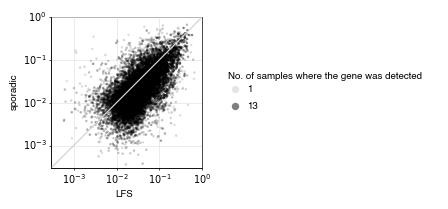

<ggplot: (8789592308800)>

In [19]:
from mizani.formatters import log_format
p = (
    ggplot(aggfsv, aes("LFS", "sporadic", alpha="ndetected"))
    + geom_point(stroke=0, size=1)
    + geom_abline(intercept=0, slope=1, color="lightgray")
    + scale_alpha_continuous(range=(0.1, 0.5), breaks=(1, 13), name="No. of samples where the gene was detected")
    + scale_x_log10(limits=(3e-4, 1), expand=(0, 0), labels=log_format(exponent_limits=(0, 0), mathtex=True))
    + scale_y_log10(limits=(3e-4, 1), expand=(0, 0), labels=log_format(exponent_limits=(0, 0), mathtex=True))
    + guides(alpha=guide_legend(override_aes={"size": 3}))
    + theme(figure_size=(1.95, 1.95))
)
p.save("figures/1A_FSV.svgz")
p

/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 3 x 1.95 in image.
/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/S1.5.svgz
/home/kats/.local/lib/python3.10/site-packages/plotnine/layer.py:333: PlotnineWarning: stat_ydensity : Removed 654 rows containing non-finite values.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:694: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. 

/home/kats/.local/lib/python3.10/site-packages/plotnine/layer.py:333: PlotnineWarning: stat_ydensity : Removed 654 rows containing non-finite values.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:694: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `seri

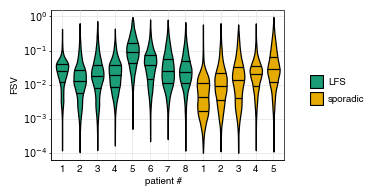

<ggplot: (8737549166040)>

In [20]:
p = (
    ggplot(
        spatialvariance.assign(
            type=lambda x: np.where(
                x["sample"].str[0].astype(int) <= 3, "LFS", "sporadic"
            ),
            sample=lambda x: x["sample"].astype(str).replace(human_sample_map)),
        aes("sample", "FSV", fill="type"),
    )
    + geom_violin(
        scale="width",
        color="black",
        n=4096,
        width=0.7,
        position=position_dodge(width=0.9),
        draw_quantiles=[0.25, 0.5, 0.75],
    )
    + scale_x_discrete(labels=lambda x: [k[-1] for k in x.keys()])
    + scale_y_log10(limits=(1e-4, 1), labels=log_format(exponent_limits=(0, 0), mathtex=True))
    + lfs_sporadic_fill_scale
    + labs(x="patient #", y="FSV", color="", fill="")
    + guides(color=guide_legend(override_aes={"size": 2, "alpha": 1}))
    + theme(
        aspect_ratio="auto",
        figure_size=(3, 1.95),
        axis_ticks_major_x=element_blank(),
    )
)
p.save("figures/S1.5.svgz")
p

For completeness' sake, we also plot the total spatial variance as above.

In [21]:
aggsv = (
    spatialvariance.groupby(["type", "gene"])["max_s2_t_hat"]
    .agg("mean")
    .reset_index()
    .pivot(index="gene", columns="type")
    .droplevel(0, axis=1)
    .assign(ndetected=spatialvariance.groupby("gene").size())
    .reset_index()
)

/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 1.95 x 1.95 in image.
/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/S5_SV.svgz
/home/kats/.local/lib/python3.10/site-packages/plotnine/layer.py:411: PlotnineWarning: geom_point : Removed 1317 rows containing missing values.
/home/kats/.local/lib/python3.10/site-packages/plotnine/layer.py:411: PlotnineWarning: geom_point : Removed 1317 rows containing missing values.


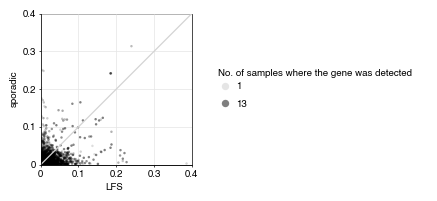

<ggplot: (8737616164309)>

In [22]:
p = (
    ggplot(aggsv, aes("LFS", "sporadic", alpha="ndetected"))
    + geom_point(stroke=0, size=1)
    + geom_abline(intercept=0, slope=1, color="lightgray")
    + scale_alpha_continuous(range=(0.1, 0.5), breaks=(1, 13), name="No. of samples where the gene was detected")
    + scale_x_continuous(limits=(0, 0.4), expand=(0, 0))
    + scale_y_continuous(limits=(0, 0.4), expand=(0, 0))
    + guides(alpha=guide_legend(override_aes={"size": 3}))
    + theme(figure_size=(1.95, 1.95))
)
p.save("figures/S5_SV.svgz")
p

We plot the FSV in a few selected genes to include in the figures.

/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 0.3 x 1 in image.
/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/3A_VEGFA_dotplot.svgz


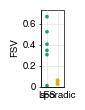

/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 0.3 x 1 in image.
/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/3A_IL32_dotplot.svgz


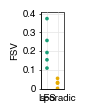

/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 0.3 x 1 in image.
/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/3A_PDGFRB_dotplot.svgz


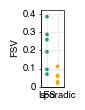

/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 0.3 x 1 in image.
/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/3A_VWF_dotplot.svgz


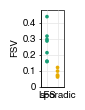

/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 0.3 x 1 in image.
/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/3A_WNT4_dotplot.svgz


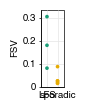

In [23]:
for gene in ("VEGFA", "IL32", "PDGFRB", "VWF", "WNT4"):
    p = (
        ggplot(
            spatialvariance[spatialvariance.gene == gene],
            aes("type", "FSV", color="type"),
        )
        + geom_jitter(stroke=0, position=position_dodge(width=0.3))
        + lfs_sporadic_color_scale
        + scale_y_continuous(limits=(0, None), expand=(0, 0, 0.1, 0))
        + labs(x=None, color="")
        + theme(aspect_ratio="auto", figure_size=(0.3,1), axis_ticks_major_x=element_blank())
        + guides(color=None)
    )
    p.save(f"figures/3A_{gene}_dotplot.svgz")
    print(p)

We will now attempt to map tumor clones to the spatial samples. We know that there are two major clones in the patient corresponding to samples 1.3 and 3.4, and that these clones differ in copy numbers of chromosomes 8 and 12. The general strategy is to cluster spots based on expression of genes located on these chromosomes only.

First, we get the chromosome locations of all genes from BioMart.

In [24]:
from bioservices import BioMart
from io import StringIO
from functools import reduce

s = BioMart()
s.add_dataset_to_xml("hsapiens_gene_ensembl")
s.add_attribute_to_xml("ensembl_gene_id")
s.add_attribute_to_xml("chromosome_name")
s.add_filter_to_xml(
    "ensembl_gene_id",
    ",".join(
        reduce(
            lambda a, b: np.union1d(a, b),
            [s.var.gene_ids.to_numpy() for s in adatas.values()],
        ).tolist()
    ),
)
res = s.query(s.get_xml())
gene2chromosome = pd.read_table(
    StringIO(res), names=["ensembl_gene_id", "chromosome_name"]
)

We now get the list of genes on chromosomes 8 and 12.

In [25]:
clonegenes = (
    pd.concat([s.var.gene_ids for s in adatas.values()], axis=0)
    .drop_duplicates()
    .reset_index()
    .set_index("gene_ids")
    .loc[
        gene2chromosome[
            gene2chromosome.chromosome_name.isin(("8", "12"))
        ].ensembl_gene_id
    ]
    .iloc[:, 0]
    .to_list()
)

We use SpatialDE's spatial clustering algorithm with hand-tuned parameters to obtain exactly two clusters with the list of genes generated above.

In [26]:
segmentations = {}
for sample in ("1.3", "3.4"):
    adata = adatas[sample]
    ccgenes = list(filter(lambda x: x in adata.var_names, clonegenes))
    segmentations[sample], cadata = SpatialDE.tissue_segmentation(
        adata,
        layer="counts",
        genes=ccgenes,
        rng=np.random.default_rng(42),
        copy=True,
        params=SpatialDE.TissueSegmentationParameters(
            smoothness_factor=0.35, neighbors=15
        ),
    )
    adata.obs["segmentation_labels_clonegenes"] = cadata.obs.segmentation_labels

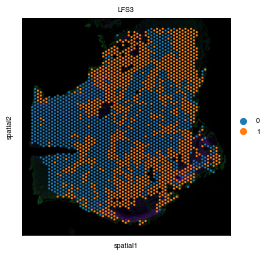

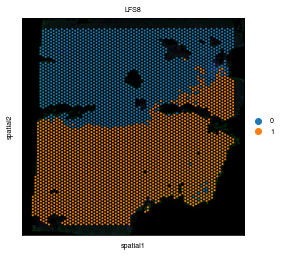

In [27]:
for sample in ("1.3", "3.4"):
    sc.pl.spatial(adatas[sample], color="segmentation_labels_clonegenes", title=human_sample_map[sample])

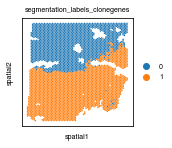

In [28]:
with mpl.rc_context({"figure.figsize": (6, 2)}):
    sc.pl.spatial(adatas["3.4"], color="segmentation_labels_clonegenes", img_key=None, size=1.5, show=False)
    plt.savefig("figures/4A.svgz")
    plt.show()

Here we plot normalized gene expression for each gene on chr. 8 and 12 individually for each cluster.

In [29]:
df = pd.concat(
    (
        sc.get.obs_df(
            adatas[sample],
            keys=["segmentation_labels_clonegenes"]
            + list(filter(lambda x: x in adatas[sample].var_names, clonegenes)),
        )
        .melt(
            id_vars=["segmentation_labels_clonegenes"],
            var_name="gene",
            value_name="norm_expression",
        )
        .assign(sample=human_sample_map[sample])
        for sample in ("1.3", "3.4")
    )
)
(
    ggplot(
        df,
        aes("sample", "norm_expression", color="segmentation_labels_clonegenes"),
    )
    + geom_sina(shape=".", alpha=0.2, scale="width")
    + facet_wrap("gene", ncol=10)
    + theme(dpi=200, figure_size=(20, 180), axis_text_x=element_text(rotation=45))
)

<ggplot: (8737582810566)>

The above plot is not very informative, so we aggregate: We plot average expression of each gene on chr. 8 and 12 for each cluster. We observe that cluster 1 has on average slightly higher gene expression, indicating higher copy number.

/home/kats/.local/lib/python3.10/site-packages/plotnine/layer.py:333: PlotnineWarning: stat_sina : Removed 90 rows containing non-finite values.


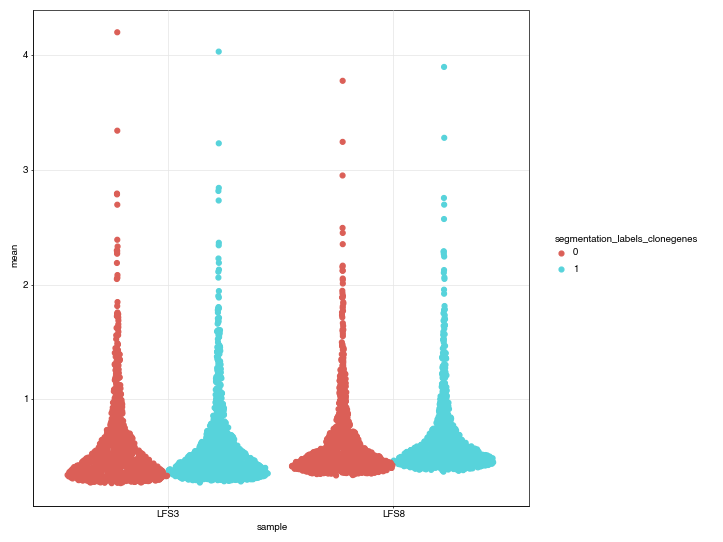

<ggplot: (8737090649356)>

In [30]:
df = (
    df.groupby(["sample", "gene", "segmentation_labels_clonegenes"])
    .aggregate(
        mean=("norm_expression", lambda df: df[df > 0].mean(0)),
        median=("norm_expression", lambda df: df[df > 0].median(0)),
        frac_nonzero=(
            "norm_expression",
            lambda df: np.sum(df.to_numpy() > 0, 0) / df.shape[0],
        ),
    )
    .reset_index()
)
ggplot(
    df,
    aes("sample", "mean", color="segmentation_labels_clonegenes"),
) + geom_sina(scale="width")

In [37]:
adatas["3.4"].write_h5ad("adatas/3.4.h5ad", compression="gzip", compression_opts=9)

/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 1 x 1.95 in image.
/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/S11_violin.svgz
/home/kats/.local/lib/python3.10/site-packages/plotnine/layer.py:333: PlotnineWarning: stat_ydensity : Removed 80 rows containing non-finite values.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:694: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with 

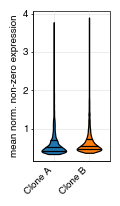

In [31]:
p = (
    ggplot(
        df[df["sample"] == human_sample_map["3.4"]],
        aes(
            "segmentation_labels_clonegenes",
            "mean",
            fill="segmentation_labels_clonegenes",
        ),
    )
    + geom_violin(
        scale="width",
        color="black",
        n=4096,
        width=0.7,
        draw_quantiles=[0.25, 0.5, 0.75],
    )
    + scale_x_discrete(labels=["Clone A", "Clone B"])
    + scale_fill_manual(
        values=adatas["3.4"].uns["segmentation_labels_clonegenes_colors"], labels=["Clone A", "Clone B"]
    )
    + labs(x=None, y="mean norm. non-zero expression", fill="")
    + guides(fill=None)
    + theme(
        axis_text_x=element_text(rotation=45, ha="right"),
        axis_ticks_major_x=element_blank(),
        aspect_ratio="auto",
        figure_size=(1, 1.95),
    )
)
p.save("figures/S11_violin.svgz")
print(p)

We repeat the clone assignment, but using Leiden clustering.

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


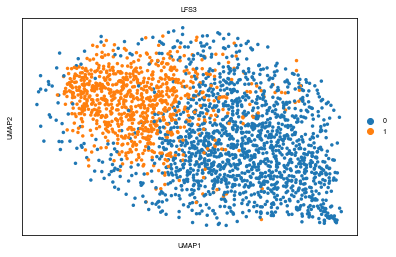

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


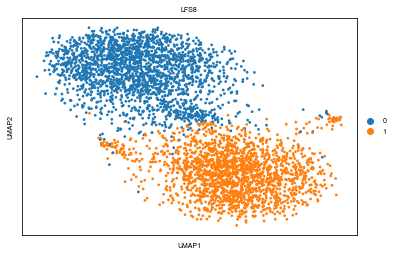

In [32]:
for sname, res in zip(("1.3", "3.4"), (0.55, 0.4)):
    sample = adatas[sname]
    cgenes = list(filter(lambda x: x in sample.var_names, clonegenes))
    sample.obsm["clonegenes"] = sample[:, cgenes].X.copy()
    sc.pp.neighbors(sample, n_neighbors=15, use_rep="clonegenes", key_added="cloneneighbors")
    sc.tl.umap(sample, neighbors_key="cloneneighbors", min_dist=0.001, spread=2)
    sc.tl.leiden(sample, neighbors_key="cloneneighbors", resolution=res)
    sc.pl.umap(sample, title=human_sample_map[sname], color="leiden")

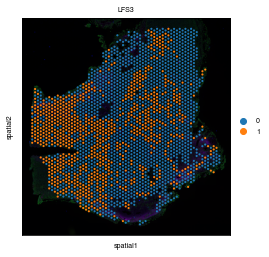

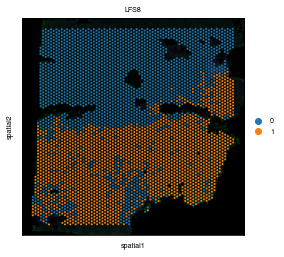

In [33]:
for sname in ("1.3", "3.4"):
    sc.pl.spatial(adatas[sname], color="leiden", title=human_sample_map[sname])

/home/kats/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


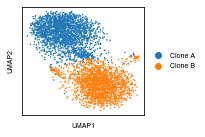

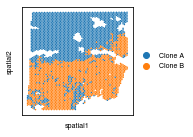

In [34]:
adatas["3.4"].obs["leiden_labels"] = adatas["3.4"].obs.leiden.cat.rename_categories({"0": "Clone A", "1": "Clone B"})
with mpl.rc_context({"figure.figsize": (2.2, 2)}):
    sc.pl.umap(adatas["3.4"], color="leiden_labels", title="", size=9, show=False)
    plt.savefig("figures/S11_umap.svgz")
    
    sc.pl.spatial(adatas["3.4"], color="leiden_labels", title="", size=1.5, img_key=None, show=False)
    plt.savefig("figures/S11_spatial.svgz")

We will attempt to find differences in nuclear morphology between the clones. We will use the nuclei segmentation masks from the previous notebook.

In [35]:
clone0, clone1 = (
    adatas["3.4"].obsm["spatial"][adatas["3.4"].obs.segmentation_labels_clonegenes == i]
    for i in range(2)
)

To avoid having to focus only on spots, potentially losing a lot of sample area, and because the clones  in the LSF8 sample form nice contiguous regions, we will assign a chunk of the Visium slide to each clone. First, we determine the connected components separately for each clone using a nearest-neighbor graph where each spot is connected only to its immediate neighbors and use the largest connected component for each clone to define the area of the slide belonging to the clone. We use the alphashape package to determine the concave hull of the spots in a connected component.

In [36]:
shapes = []
for clone in (clone0, clone1):
    pdists = squareform(pdist(clone))
    np.fill_diagonal(pdists, np.inf)
    mindist = pdists.min()
    pdists[pdists > 1.2 * mindist] = 0
    n_comps, clabels = connected_components(pdists, directed=False)

    uclabels, cnts = np.unique(clabels, return_counts=True)
    clone = clone[clabels == uclabels[np.argmax(cnts)], :]
    alpha_shape = alphashape(clone)
    shapes.append(alpha_shape)

/home/kats/.local/lib/python3.10/site-packages/shapely/ops.py:42: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
/home/kats/.local/lib/python3.10/site-packages/alphashape/optimizealpha.py:41: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.


/home/kats/.local/lib/python3.10/site-packages/descartes/patch.py:62: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.


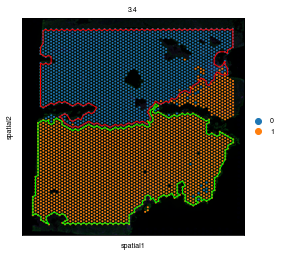

In [37]:
sc.pl.spatial(
    adatas["3.4"], color="segmentation_labels_clonegenes", title="3.4", show=False
)
scalef = adatas["3.4"].uns["spatial"]["3.4"]["scalefactors"]["tissue_hires_scalef"]
plt.gcf().axes[0].add_patch(
    PolygonPatch(
        scale(shapes[0], scalef, scalef, origin=(0, 0)), fc="#00000000", ec="#ff0000"
    )
)
plt.gcf().axes[0].add_patch(
    PolygonPatch(
        scale(shapes[1], scalef, scalef, origin=(0, 0)), fc="#00000000", ec="#00ff00"
    )
)

We now load the segmentation masks and the DAPI image.

In [38]:
with np.load("segmentation/3.4_cellpose.npz") as segmentation:
    masks = segmentation["masks"]

In [39]:
dapi = skimage.io.imread(
    "../../raw_data/2022-06/images/2022-03-02/capture area 4/FFPE_run3_20220302_Layer3-EFI 20x_04_CH0-DAPI.tif"
)

We use scikit-image to measure features of the segmentation masks and the DAPI staining. A mask is assigned to a clone based on which sample region its centroid falls into. A mask is skipped if its centroid does not fall in one of the two regions defined above.

In [40]:
df = []
for mask in skimage.measure.regionprops(masks, dapi):
    if shapes[0].contains(Point(mask.centroid[::-1])):
        clone = 0
    elif shapes[1].contains(Point(mask.centroid[::-1])):
        clone = 1
    else:
        continue
    df.append(
        {
            "label": mask.label,
            "clone": clone,
            "area": mask.area,
            "mean_intensity": mask.intensity_mean,
            "perimeter": mask.perimeter,
            "ellipse_major": mask.axis_major_length,
            "ellipse_minor": mask.axis_minor_length,
        }
    )
df = pd.DataFrame(df)
df["clone"] = pd.Categorical(df["clone"])
df["circularity"] = df.perimeter**2 / (4 * np.pi * df["area"])
df["roundness"] = df.ellipse_minor / df.ellipse_major
df = df.reset_index(drop=True)

We plot the nucleus area for the two clones.

/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 1 x 1.95 in image.
/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/4_nuclei_area.svgz
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:694: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local

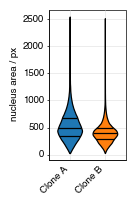

In [41]:
p = (
    ggplot(df, aes("clone", "area", fill="clone"))
    + geom_violin(
        scale="width",
        color="black",
        n=4096,
        width=0.7,
        draw_quantiles=[0.25, 0.5, 0.75],
    )
    + scale_x_discrete(labels=["Clone A", "Clone B"])
    + scale_fill_manual(
        values=adatas["3.4"].uns["segmentation_labels_clonegenes_colors"],
        labels=["Clone A", "Clone B"],
    )
    + guides(fill=None)
    + labs(x=None, y="nucleus area / px")
    + theme(
        axis_text_x=element_text(rotation=45, ha="right"),
        axis_ticks_major_x=element_blank(),
        aspect_ratio="auto",
        figure_size=(1, 1.95),
    )
)
p.save("figures/4_nuclei_area.svgz")
print(p)

In [42]:
mannwhitneyu(df.area[df.clone == 0], df.area[df.clone == 1])

MannwhitneyuResult(statistic=16313602146.5, pvalue=0.0)